## Поиск Finder Pattern'ов QR-кодов в изображениях

### Подготовка

In [206]:
import cv2
from PIL import Image

from os import path, listdir

from random import choice

from typing import List, Tuple

In [40]:
TEST_BASE_DIR = path.join("tests")
TEST_DIRS = [path.join(TEST_BASE_DIR, "set_1"),
             path.join(TEST_BASE_DIR, "set_2"),
             # path.join(TEST_BASE_DIR, "set_3") # будет позже
]

SAMPLE_IMAGE = path.join(TEST_DIRS[0], choice(listdir(TEST_DIRS[0])))
print(f"Using {SAMPLE_IMAGE} as sample image")

Using tests/set_1/0017.jpg as sample image


### Черновой вариант

Давайте попробуем решить задачу для случайного изображения, которое мы выбрали на предыдущем шаге

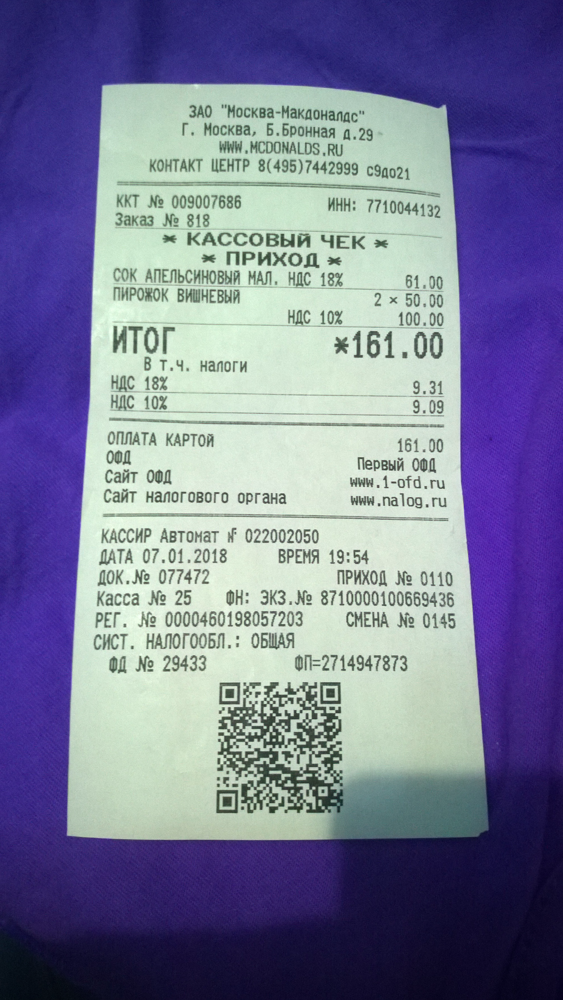

In [79]:
sample_image = cv2.imread(SAMPLE_IMAGE)

Image.fromarray(sample_image)

На изображении имеется QR-код. Попробуем достать его с помощью уже реализованного детектора из библиотеки OpenCV:

In [42]:
detector = cv2.QRCodeDetector()

In [44]:
found, points = detector.detectMulti(sample_image)

In [45]:
found

True

In [46]:
points.shape

(1, 4, 2)

In [47]:
points[0]

array([[ 780.     , 2425.     ],
       [1209.     , 2423.     ],
       [1222.4757 , 2892.22   ],
       [ 767.00006, 2887.9534 ]], dtype=float32)

In [49]:
points

array([[[ 780.     , 2425.     ],
        [1209.     , 2423.     ],
        [1222.4757 , 2892.22   ],
        [ 767.00006, 2887.9534 ]]], dtype=float32)

Детектор справился с задачей, давайте посмотрим на прямоугольник, который он выделил:

In [69]:
with_rectangle = cv2.rectangle(sample_image, points[0][0].astype(int), points[0][-2].astype(int), (255, 0, 0))

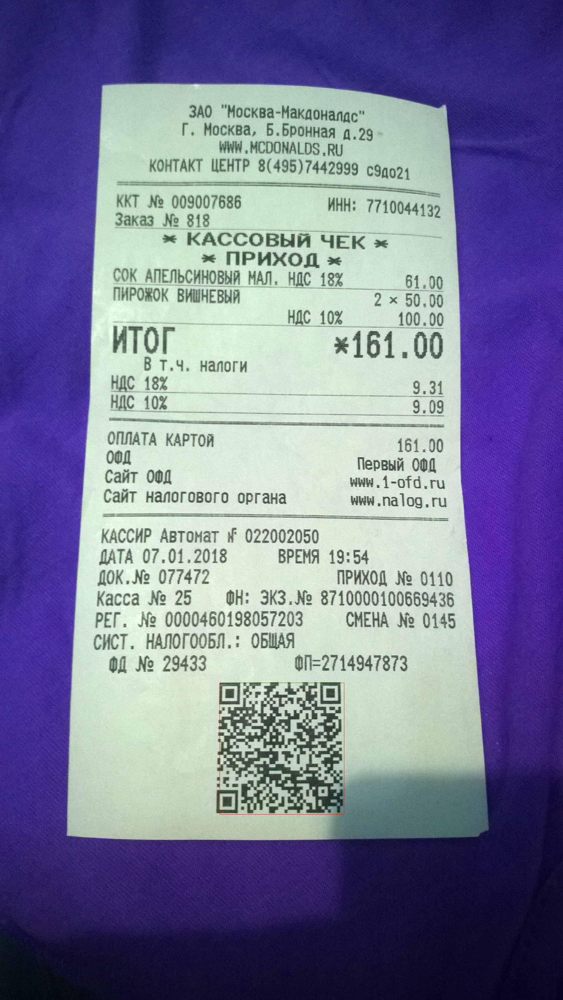

In [70]:
Image.fromarray(with_rectangle)

Однако в общем случае мы получим не прямоугольник, а некоторый четырёхугольник. Давайте сведём нашу задачу к поиску Finder Pattern'ов в прямоугольнике, сделав замену координат:

In [101]:
import numpy as np

TRANSFORMED_SIZE = 512

dst = np.float32([[0, 0],
                  [TRANSFORMED_SIZE, 0],
                  [TRANSFORMED_SIZE, TRANSFORMED_SIZE],
                  [0, TRANSFORMED_SIZE]])

matrix = cv2.getPerspectiveTransform(points[0], dst)

In [102]:
res = cv2.warpPerspective(sample_image, matrix, (TRANSFORMED_SIZE, TRANSFORMED_SIZE))

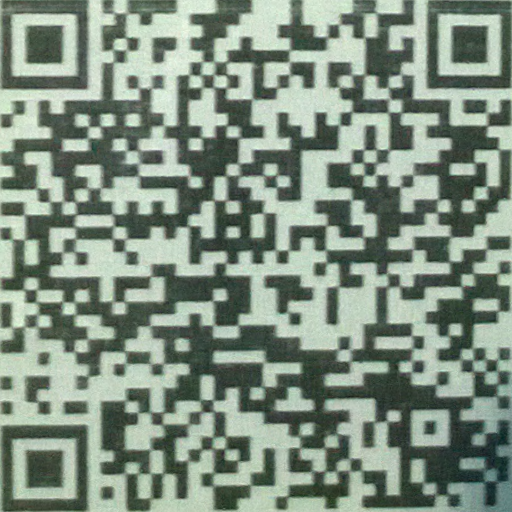

In [103]:
Image.fromarray(res)

С таким изображением гораздо проще работать, теперь мы можем явно задать координаты Finder Pattern'ов в нём:

In [157]:
res_copy = res.copy()

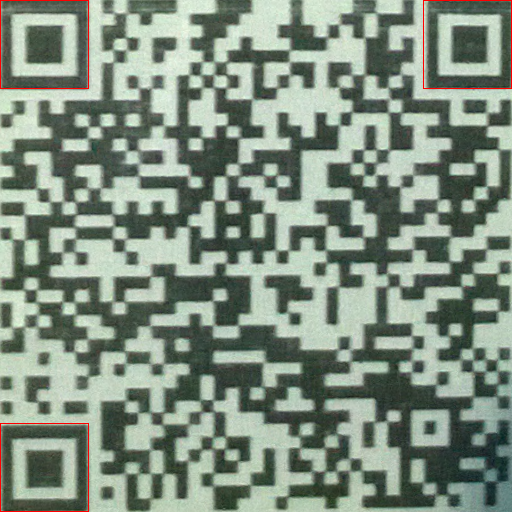

In [159]:
FP_SIZE = 88 # Эмпирически подобранное значение

x_1, y_1, w_1, h_1 = rect_1 = [0, 0, FP_SIZE, FP_SIZE]
x_2, y_2, w_2, h_2 = rect_2 = [0, TRANSFORMED_SIZE - 1 - FP_SIZE, FP_SIZE, FP_SIZE]
x_3, y_3, w_3, h_3 = rect_3 = [TRANSFORMED_SIZE - 1 - FP_SIZE, 0, FP_SIZE, FP_SIZE]

cv2.rectangle(res_copy, (x_1, y_1), (x_1 + w_1, y_1 + h_1), (255, 0, 0))
cv2.rectangle(res_copy, (x_2, y_2), (x_2 + w_2, y_2 + h_2), (255, 0, 0))
cv2.rectangle(res_copy, (x_3, y_3), (x_3 + w_3, y_3 + h_3), (255, 0, 0))

Image.fromarray(res_copy)

Посмотрим, как будут выглядеть наши выделенные Finder Pattern'ы в исходном изображении:

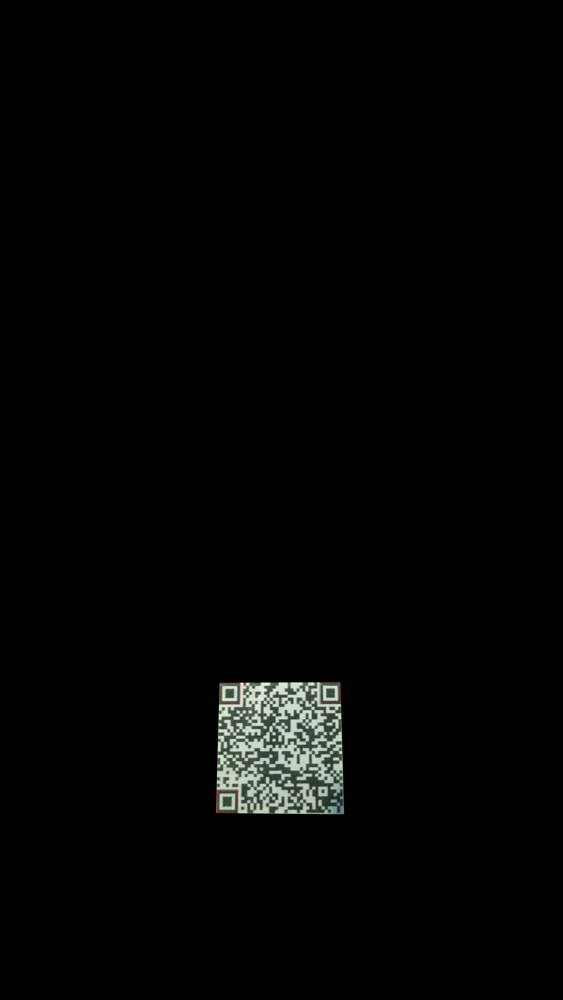

In [160]:
inverse_matrix = cv2.getPerspectiveTransform(dst, points[0])
with_qr = cv2.warpPerspective(res_copy, inverse_matrix, (sample_image.shape[1], sample_image.shape[0]))

Image.fromarray(with_qr)

Теперь нам нужно получить координаты этих четырёхугольников в исходном изображении, а затем описать около них четырёхугольники, которые будут обозначать искомые Bounding Box'ы (это необходимо сделать, поскольку при переходе в другую систему координат прямоугольники не обязаны оставаться прямоугольниками)

In [168]:
def get_original_coords(x, y, inverse_matrix):    
    warped_point = np.array([x, y, 1])

    original_x, original_y, z = np.dot(inverse_matrix, warped_point)

    original_x /= z
    original_y /= z

    return int(original_x), int(original_y)


def get_original_from_rectangle(rectangle, inverse_matrix):
    x, y, w, h = rectangle

    coords = [get_original_coords(x, y, inverse_matrix),
              get_original_coords(x, y + h, inverse_matrix),
              get_original_coords(x + w, y + h, inverse_matrix),
              get_original_coords(x + w, y, inverse_matrix)]

    return coords

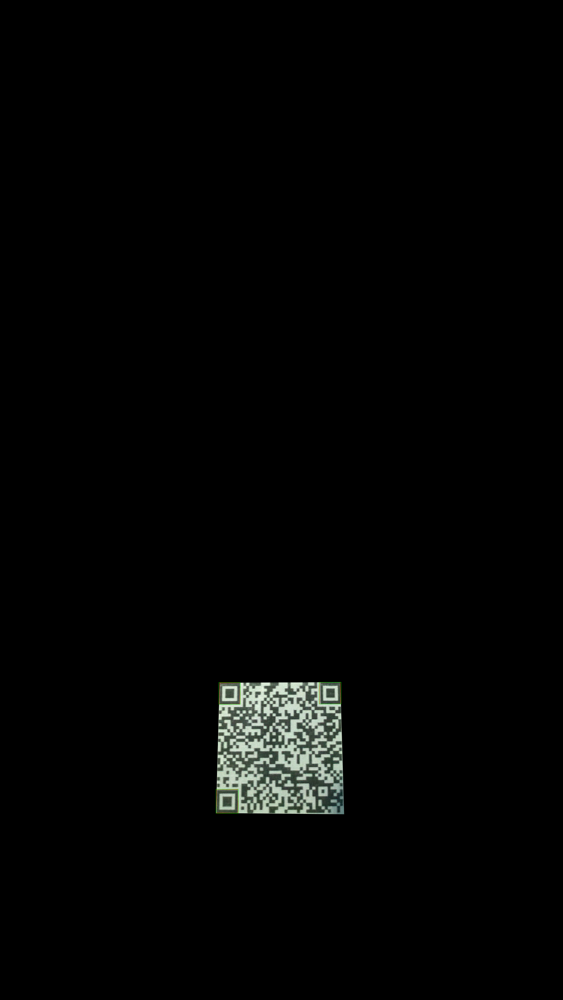

In [179]:
for rect in [rect_1, rect_2, rect_3]:
    # Получаем координаты в исходном изображении
    original_coords = get_original_from_rectangle(rect, inverse_matrix)
    
    # Описываем около выбранных точек прямоугольник
    x_b, y_b, w_b, h_b = bounding_rect = cv2.boundingRect(np.array(original_coords))

    # Фиксируем Bounding Box'ы на изображении
    cv2.rectangle(with_qr, (x_b, y_b), (x_b + w_b, y_b + h_b), (0, 255, 0))

# Наслаждаемся результатом
Image.fromarray(with_qr)

Отлично, мы научились находить в исходном изображении finder pattern'ы QR-кодов. Давайте теперь объединим все наши шаги и получим end2end решение:

### Чистовое решение

In [228]:
def extract_finder_patterns(filepath: str) -> Tuple[bool, List[List[List[int]]]]:
    """
    Функция для извлечения finder pattern'ов QR-кодов из изображения

    Args:
        filepath: путь к изображению

    Returns:
        (is_found: bool, bounding_boxes: List[List[BoundingBox]])
        is_found: были ли найдены QR-коды
        finder_patterns: если да, то для каждого из них список Bounding Box'ов в виде (x_0, y_0, w, h)
    """

    image = cv2.imread(filepath)

    detector = cv2.QRCodeDetector()
    is_found, qr_codes = detector.detectMulti(image)

    if not is_found:
        return False, []

    bounding_boxes = [[] for _ in range(len(qr_codes))]

    for i, qr_code in enumerate(qr_codes):
        # Размер стороны QR-кода в новой системе координат
        TRANSFORMED_SIZE = 512

        dst = np.float32([[0, 0],
                        [TRANSFORMED_SIZE, 0],
                        [TRANSFORMED_SIZE, TRANSFORMED_SIZE],
                        [0, TRANSFORMED_SIZE]])

        # Построение прямого перехода нам уже не нужно, оставим только обратный
        inverse_matrix = cv2.getPerspectiveTransform(dst, qr_code)

        # Размер finder pattern'а
        FP_SIZE = 88

        # Все три finder pattern'а
        fp_1 = [0, 0, FP_SIZE, FP_SIZE]
        fp_2 = [TRANSFORMED_SIZE - 1 - FP_SIZE, 0, FP_SIZE, FP_SIZE]
        fp_3 = [0, TRANSFORMED_SIZE - 1 - FP_SIZE, FP_SIZE, FP_SIZE]

        for fp in [fp_1, fp_2, fp_3]:
            # Получаем координаты в исходном изображении
            original_coords = get_original_from_rectangle(fp, inverse_matrix)
            
            # Описываем около выбранных точек прямоугольник
            bounding_rect = cv2.boundingRect(np.array(original_coords))
            bounding_boxes[i].append(bounding_rect)

    return True, bounding_boxes

Пригодится и функция, которая сразу рисует наши искомые Finder Pattern'ы:

In [229]:
def draw_finder_patterns(filepath: str):
    image = cv2.imread(filepath)
    is_found, finder_patterns = extract_finder_patterns(filepath)

    if not is_found:
        return False, image
    
    
    for finder_pattern in finder_patterns:
        for bounding_box in finder_pattern:
            x_b, y_b, w_b, h_b = bounding_box
            cv2.rectangle(image, (x_b, y_b), (x_b + w_b, y_b + h_b), (255, 0, 0))

    return True, image

Проверим, как всё работает:

In [230]:
is_found, bounding_boxes = extract_finder_patterns(SAMPLE_IMAGE)

bounding_boxes

[[(777, 2424, 76, 77), (1133, 2423, 78, 77), (767, 2803, 79, 85)]]

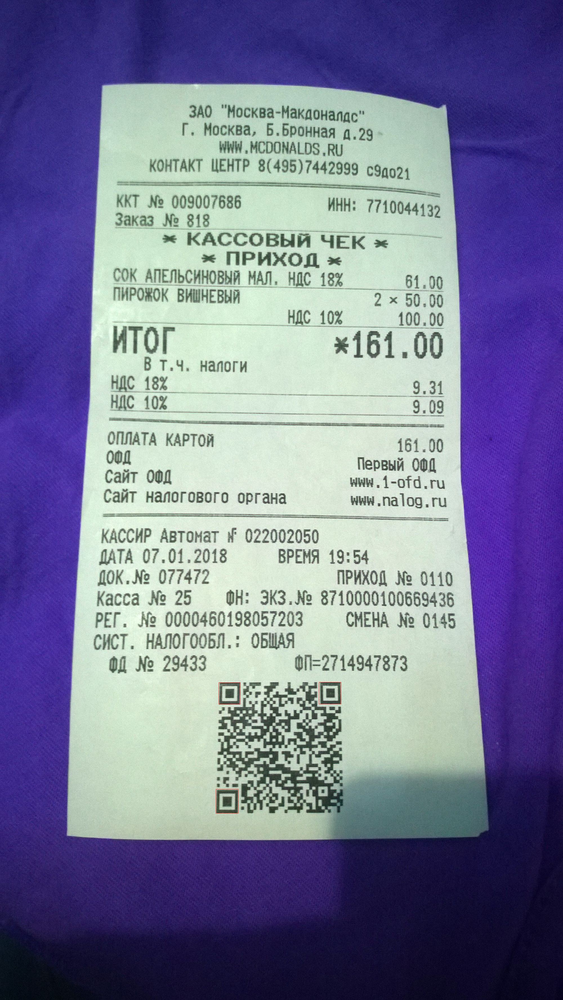

In [205]:
is_found, drawn_image = draw_finder_patterns(SAMPLE_IMAGE)

assert is_found, "На изображении не найден QR-код"

Image.fromarray(drawn_image)

Ура, Finder Pattern'ы на нужном месте. Однако для оценки качества одного изображения мало, пришло время протестироваться на всей выборке.

### Тестирование

Мы предсказывали Bounding Box'ы, а значит и тестироваться нам нужно на них. Преобразуем ручную разметку к тому же виду, что мы использовали выше:

In [241]:
def get_target(filepath: str) -> List[List[List[int]]]:
    # Для каждого QR кода три записи
    finder_patterns = []

    new_filepath = filepath.replace("tests", "targets").replace("jpg", "txt")

    with open(new_filepath, "rt") as file:
        data = file.readlines()

        for i, line in enumerate(data):
            qr_code_idx = i // 3

            y, x, h, w = map(int, line.split())

            if len(finder_patterns) == qr_code_idx:

                finder_patterns.append([])


            finder_patterns[-1].append([x, y, w, h])

    # Отсортируем Bounding Box'ы в соответствии с предсказаниями
    for i in range(len(finder_patterns)):
        finder_patterns[i].sort(key=lambda x: x[1])

        a, b, c = finder_patterns[i]

        if a[0] > b[0]:
            tmp = a
            finder_patterns[i][0] = b
            finder_patterns[i][1] = tmp

    finder_patterns.sort(key=lambda x: (x[1], x[0]))

    return finder_patterns

In [242]:
pred = extract_finder_patterns(SAMPLE_IMAGE)[1]

target = get_target(SAMPLE_IMAGE)

print(f"Predicted: {pred}")
print(f"Target: {target}")

Predicted: [[(777, 2424, 76, 77), (1133, 2423, 78, 77), (767, 2803, 79, 85)]]
Target: [[[778, 2425, 75, 78], [1137, 2423, 75, 78], [771, 2806, 76, 82]]]


Похоже на правду, осталось оценить с помощью какой-то метрики

Перед нами задача сегментации, поэтому основная метрика -- IoU (Intersection over Union):

In [243]:
def calculate_IoU(pred_box, target_box):
	x0_p, y0_p, w_p, h_p = pred_box
	x0_t, y0_t, w_t, h_t = target_box

	x1_p = x0_p + w_p
	y1_p = y0_p + h_p

	x1_t = x0_t + w_t
	y1_t = y0_t + h_t

	x1, y1, x2, y2 = x0_p, y0_p, x1_p, y1_p
	x3, y3, x4, y4 = x0_t, y0_t, x1_t, y1_t

	x_inter1 = max(x1, x3)
	y_inter1 = max(y1, y3)
	x_inter2 = min(x2, x4)
	y_inter2 = min(y2, y4)

	width_inter = abs(x_inter2 - x_inter1)
	height_inter = abs(y_inter2 - y_inter1)
	area_inter = width_inter * height_inter

	area_box1 = w_p * h_p
	area_box2 = w_t * h_t
	area_union = area_box1 + area_box2 - area_inter

	IoU = area_inter / area_union

	return IoU

In [249]:
print(f"IoU: {calculate_IoU(pred[0][0], target[0][0])}")

IoU: 0.9496834388537154


Мы подсчитали IoU для отдельно взятого Finder Pattern'а, а их у нас три для каждого QR-кода, поправим метрику:

In [245]:
def calculate_QR_IoU(pred, target):
    result = 0

    for i in range(len(pred)):
        result += calculate_IoU(pred[i], target[i])
    
    result /= 3

    return result

In [250]:
print(f"QR IoU: {calculate_QR_IoU(pred[0], target[0])}")

QR IoU: 0.9265982690247703


In [253]:
# Будем считать, что если значение метрики не ниже THRESHOLD, то это True Positive
THRESHOLD = 0.75

In [261]:
from tqdm import tqdm

def calculate_test_set_metrics(dirpath: str):
    TP = 0
    FP = 0
    FN = 0

    for filename in tqdm(listdir(dirpath), desc=f"{dirpath}"):
        filepath = path.join(dirpath, filename)

        is_found, preds = extract_finder_patterns(filepath)
        targets = get_target(filepath)

        pred_matched = [False for _ in range(len(preds))]
        target_matched = [False for _ in range(len(targets))]

        for i, target in enumerate(targets):
            if target_matched[i]:
                continue

            for j, pred in enumerate(preds):
                if pred_matched[j]:
                    continue

                QR_IoU = calculate_QR_IoU(pred, target)

                if QR_IoU >= THRESHOLD:
                    target_matched[i] = True
                    pred_matched[j] = True


        total_pred_matched = sum(pred_matched)
        total_target_matched = sum(target_matched)

        TP += total_target_matched

        FP += len(pred_matched) - total_target_matched

        FN += len(target_matched) - total_target_matched

    precision = TP / (TP + FP)
    recall = TP / (TP + FN)
    f1 = 2 * precision * recall / (precision + recall)

    return precision, recall, f1

In [262]:
%%time

for test_set in TEST_DIRS:
    print(f"Тестируемся на {test_set}")
    precision, recall, f1 = calculate_test_set_metrics(test_set)

    print(f"Precision: {precision}")
    print(f"Recall: {recall}")
    print(f"F1: {f1}")
    print()

Тестируемся на tests/set_1


tests/set_1: 100%|██████████| 47/47 [06:08<00:00,  7.83s/it]


Precision: 0.7419354838709677
Recall: 0.4791666666666667
F1: 0.5822784810126582

Тестируемся на tests/set_2


tests/set_2: 100%|██████████| 48/48 [02:16<00:00,  2.84s/it]

Precision: 0.26666666666666666
Recall: 0.16666666666666666
F1: 0.2051282051282051

CPU times: user 15min 31s, sys: 2min 31s, total: 18min 2s
Wall time: 8min 24s


Перед выводами посчитаем время работы:

In [264]:
# Данные из вывода ячейки выше
total_time = 15 * 60 + 31
total_files = 47 + 48

seconds_per_file = total_time / total_files

print(f"Средняя скорость работы: {seconds_per_file} секунд на 1 файл")

Средняя скорость работы: 9.8 секунд на 1 файл


Что касается метрик, они ниже, чем хотелось бы. Программа очень сильно полагается на `QRCodeDetector`, который достаточно часто не выделяет QR-коды.